In [1]:
from pathlib import Path
import pandas as pd
import plotly.express as px

In [2]:
example_data_path = "../data sets/HAPT Data Set/RawData/acc_exp01_user01.txt"

df = pd.read_csv(
    example_data_path, header=None, sep=" ", names=["x_accel", "y_accel", "z_accel"]
)

labels_path = "../data sets/HAPT Data Set/RawData/labels.txt"

labels = pd.read_csv(
    labels_path,
    header=None,
    sep=" ",
    names=["experiment_num", "user_id", "activity_id", "start_idx", "end_idx"],
)

In [3]:
activity_labels = {
    1: "WALKING",
    2: "WALKING_UPSTAIRS",
    3: "WALKING_DOWNSTAIRS",
    4: "SITTING",
    5: "STANDING",
    6: "LAYING",
    7: "STAND_TO_SIT",
    8: "SIT_TO_STAND",
    9: "SIT_TO_LIE",
    10: "LIE_TO_SIT",
    11: "STAND_TO_LIE",
    12: "LIE_TO_STAND",
}

In [4]:
exp1_user1_label = labels[(labels['experiment_num']==1) & (labels['user_id']==1)]

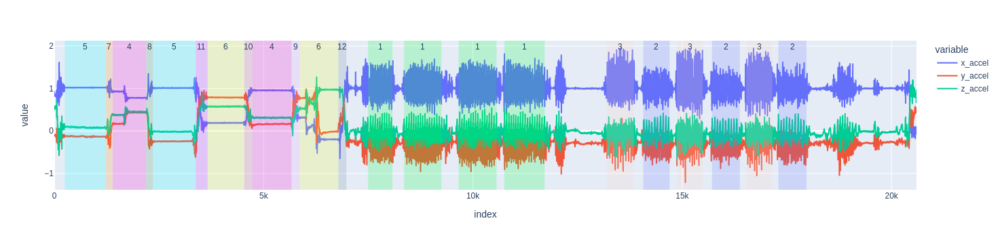

In [5]:
fig = px.line(df)

for index, row in exp1_user1_label.iterrows():
    fig.add_vrect(
        x0=row['start_idx'], x1=row['end_idx'],
        annotation_text=str(row['activity_id']),
        annotation_position="top",
        annotation_font_size=12,
        fillcolor=px.colors.qualitative.Light24[row['activity_id']],
        opacity=0.2,
        line_width=0
    )

fig.show()

In [229]:
sample_rate_hz = 50
chunk_time_s = 0.5
chunk_len = int(chunk_time_s * sample_rate_hz)

In [88]:
from tensorflow.keras import Sequential, Input
from tensorflow.keras.layers import LSTM, Dense, RepeatVector, TimeDistributed
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator

In [79]:
df.values[:][0:6]

array([[ 0.91805559, -0.1125    ,  0.50972225],
       [ 0.91111113, -0.09305556,  0.53750004],
       [ 0.8819445 , -0.08611111,  0.51388893],
       [ 0.8819445 , -0.08611111,  0.51388893],
       [ 0.87916671, -0.1       ,  0.50555558],
       [ 0.88888896, -0.10555556,  0.51250004]])

In [230]:
batches = (df.shape[0] // chunk_len)
df = df[0:batches * chunk_len]

In [231]:
X = df.values.reshape(batches, chunk_len, 3)

In [232]:
X.shape

(820, 25, 3)

In [233]:
#encoder
encoder = Sequential()
encoder.add(Input(shape=(chunk_len, 3)))
encoder.add(LSTM(128, return_sequences=True))
encoder.add(LSTM(64, return_sequences=True))
encoder.add(LSTM(8, return_sequences=False))

glue = Sequential()
glue.add(RepeatVector(chunk_len))

# decoder
decoder = Sequential()
decoder.add(LSTM(8, return_sequences=True))
decoder.add(LSTM(64, return_sequences=True))
decoder.add(LSTM(128, return_sequences=True))
decoder.add(TimeDistributed(Dense(3)))

model = Sequential([encoder, glue, decoder])

model.compile(optimizer='adam', loss='mse')

In [234]:
model.fit(X, X, epochs=50)

Epoch 1/50
26/26 [==============================] - 6s 8ms/step - loss: 0.1592
Epoch 2/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0618
Epoch 3/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0463
Epoch 4/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0386
Epoch 5/50
26/26 [==============================] - 0s 8ms/step - loss: 0.0345
Epoch 6/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0316
Epoch 7/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0296
Epoch 8/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0276
Epoch 9/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0261
Epoch 10/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0249
Epoch 11/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0239
Epoch 12/50
26/26 [==============================] - 0s 7ms/step - loss: 0.0232
Epoch 13/50
26/26 [==============================

In [235]:
Y_hat = model.predict(X)

In [236]:
autoencoded_df = pd.DataFrame(Y_hat.reshape(batches * chunk_len, 3), columns=['x_accel_pred', 'y_accel_pred', 'z_accel_pred'])

In [237]:
merged_df = pd.concat([df, autoencoded_df])

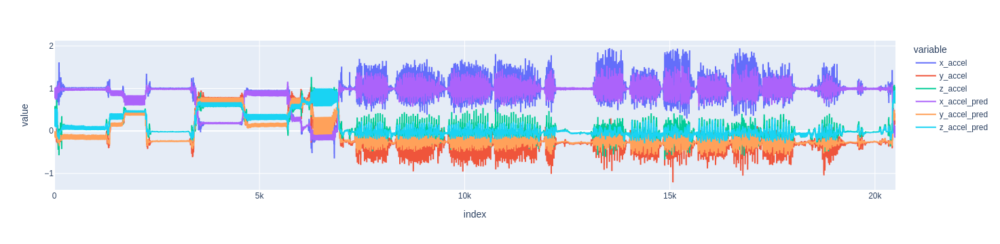

In [238]:
fig = px.line(merged_df)
fig.show()

In [239]:
encoded = encoder.predict(X)

In [240]:
encoded.shape

(820, 8)

In [244]:
encoded[0]

array([-0.78739893, -0.8845028 , -0.96859354,  0.76007485,  0.41015512,
       -0.97335863, -0.85328585, -0.36111397], dtype=float32)